In [353]:
#utilities
import requests
import json
import time
import datetime
from dateutil.parser import parse
from dateutil import tz

#analysis
import pandas as pd
from pandas.io.json import json_normalize
import numpy as np
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

#visualization
from matplotlib import pyplot as plt
import folium
import calmap
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
import plotly.io as pio
pio.renderers.default = 'jupyterlab'

#html
from IPython.display import Javascript
from IPython.core.display import display, HTML

#DB connect
from pymongo import MongoClient

In [96]:
covid_summary = requests.get('https://api.covid19api.com/summary')
summary = pd.DataFrame.from_dict(covid_summary.json()["Countries"])
date = covid_summary.json()['Date']

In [97]:
total = summary.sort_values(by='NewConfirmed', ascending=False)[['NewConfirmed', 'NewDeaths', 'NewRecovered']].sum()
total['Date'] = f'{parse(date):%d/%m/%Y %H:%M}'
total = pd.DataFrame(total).T

In [98]:
temp = summary.sort_values(by='NewConfirmed', ascending=False)[['Country', 'NewConfirmed', 'NewDeaths', 'NewRecovered']]
temp = temp.reset_index(drop=True)
temp.style.background_gradient(cmap='PuRd')

,Country,NewConfirmed,NewDeaths,NewRecovered
0,Italy,3526,345,192
1,Germany,1985,7,0
2,Spain,1806,191,498
3,US,1789,23,0
4,Iran,1178,135,799
5,France,1040,0,0
6,Switzerland,500,13,0
7,United Kingdom,409,0,32
8,Austria,314,0,-5
9,Netherlands,294,19,0


In [99]:
temp = summary.sort_values(by='TotalConfirmed', ascending=False)[['Country', 'TotalConfirmed', 'TotalDeaths', 'TotalRecovered']]
temp = temp.reset_index(drop=True)
temp.style.background_gradient(cmap='PuRd')

,Country,TotalConfirmed,TotalDeaths,TotalRecovered
0,China,81058,3230,68798
1,Italy,31506,2503,2941
2,Iran,16169,988,5389
3,Spain,11748,533,1028
4,Germany,9257,24,67
5,"Korea, South",8320,81,1407
6,France,7699,148,12
7,US,6421,108,17
8,Switzerland,2700,27,4
9,United Kingdom,1960,56,53


In [100]:
full_latest = pd.read_csv('./data/covid_19_clean_complete.csv')

# cases 
cases = ['Confirmed', 'Deaths', 'Recovered', 'Active']

# Active Case = confirmed - deaths - recovered
full_latest['Active'] = full_latest['Confirmed'] - full_latest['Deaths'] - full_latest['Recovered']

# replacing Mainland china with just China
full_latest['Country/Region'] = full_latest['Country/Region'].replace('Mainland China', 'China')

# filling missing values 
full_latest[['Province/State']] = full_latest[['Province/State']].fillna('')
full_latest[cases] = full_latest[cases].fillna(0)

# format datetime
full_latest['Date'] = pd.to_datetime(full_latest['Date'])

In [101]:
m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=4, zoom_start=1)

for i in range(0, len(full_latest)):
    folium.Circle(
        location=[full_latest.iloc[i]['Lat'], full_latest.iloc[i]['Long']],
        color='crimson', 
        tooltip =   '<li><bold>Country : '+str(full_latest.iloc[i]['Country/Region'])+
                    '<li><bold>Province : '+str(full_latest.iloc[i]['Province/State'])+
                    '<li><bold>Confirmed : '+str(full_latest.iloc[i]['Confirmed'])+
                    '<li><bold>Deaths : '+str(full_latest.iloc[i]['Deaths'])+
                    '<li><bold>Recovered : '+str(full_latest.iloc[i]['Recovered']),
        radius=int(full_latest.iloc[i]['Confirmed'])**1.1,
        fill_color='crimson').add_to(m)
m

In [102]:
formated_gdf = full_latest.groupby(['Date', 'Country/Region'])['Confirmed', 'Deaths', 'Recovered'].max()
formated_gdf = formated_gdf.reset_index()
formated_gdf['Date'] = pd.to_datetime(formated_gdf['Date'])
formated_gdf['Date'] = formated_gdf['Date'].dt.strftime('%d-%m-%Y')
formated_gdf['size'] = formated_gdf['Confirmed'].pow(0.3)

In [103]:
fig = px.scatter_geo(formated_gdf, locations="Country/Region", locationmode='country names', 
                     color="Confirmed", size='size', hover_name="Country/Region", 
                     range_color= [0, max(formated_gdf['Confirmed'])+2], 
                     projection="natural earth", animation_frame="Date", 
                     title='Spread over time')
fig.update(layout_coloraxis_showscale=True)
HTML(fig.to_html())

In [104]:
with open('./outputs/spreading_over_time.html', 'w') as file:
    file.write(fig.to_html())

In [105]:
# color pallette
cnf = '#393e46' # confirmed - grey
dth = '#ff2e63' # death - red
rec = '#21bf73' # recovered - cyan
act = '#fe9801' # active case - yellow

In [106]:
temp = full_latest.sort_values(by='Date').groupby('Date')['Recovered', 'Deaths', 'Active'].sum().reset_index()
temp = temp.melt(id_vars="Date", value_vars=['Recovered', 'Deaths', 'Active'],
                 var_name='Case', value_name='Count')
temp.head()

fig = px.area(temp, x="Date", y="Count", color='Case',
             title='Global: Cases over time', color_discrete_sequence = [rec, dth, act])
HTML(fig.to_html())

In [107]:
with open('./outputs/global_cases.html', 'w') as file:
    file.write(fig.to_html())

In [108]:
HTML('''<div class="flourish-embed flourish-bar-chart-race" data-src="visualisation/1571387"><script src="https://public.flourish.studio/resources/embed.js"></script></div>''')

In [109]:
temp = full_latest[full_latest['Country/Region'] == 'Thailand'].sort_values(by='Date').groupby('Date')['Recovered', 'Deaths', 'Active'].sum().reset_index()
temp = temp.melt(id_vars="Date", value_vars=['Recovered', 'Deaths', 'Active'],
                 var_name='Case', value_name='Count')
temp.head()

fig = px.area(temp, x="Date", y="Count", color='Case',
             title='Thailand: Cases over time', color_discrete_sequence = [rec, dth, act])
HTML(fig.to_html())

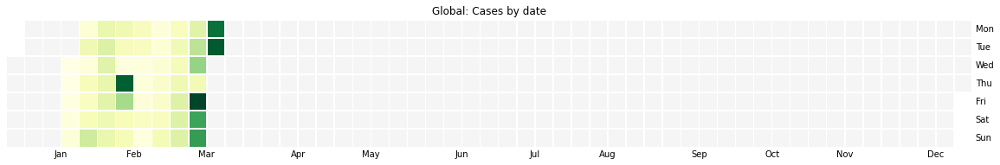

In [114]:
temp = full_latest.sort_values(by='Date').groupby('Date')['Confirmed'].sum()
temp = temp.diff()

plt.figure(figsize=(20, 5))
ax = calmap.yearplot(temp, fillcolor='whitesmoke', cmap='YlGn', linewidth=0.5)
ax.set_title('Global: Cases by date')
plt.show()

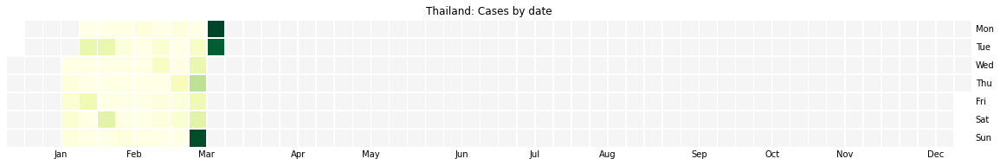

In [111]:
temp = full_latest[full_latest['Country/Region'] == 'Thailand'].sort_values(by='Date').groupby('Date')['Confirmed'].sum()
temp = temp.diff()

plt.figure(figsize=(20, 5))
ax = calmap.yearplot(temp, fillcolor='whitesmoke', cmap='YlGn', linewidth=0.5)
ax.set_title('Thailand: Cases by date')
plt.show()

In [230]:
conn = MongoClient()

In [231]:
tweets = conn['data_engineer']['tweets']

In [232]:
all_tweet_text = pd.DataFrame(list(tweets.find({}, {"_id":0, "created_at": 1, "text":1, "extended_tweet.full_text": 1})))
all_tweet_w_location = pd.DataFrame(list(tweets.find({"geo": {"$ne": "null"}}, {"_id":0, "created_at": 1, "text":1, "coordinates.coordinates": 1, "place.name": 1})))

In [233]:
all_tweet_w_location.dropna(inplace=True)

In [234]:
long = []
lat = []
for key, value in all_tweet_w_location.coordinates.items():
    for k, v in value.items():
        long.append(v[0])
        lat.append(v[1])

In [235]:
place = []
for key, value in all_tweet_w_location.place.items():
    for k, v in value.items():
        place.append(v)

In [236]:
all_tweet_w_location['long'] = long
all_tweet_w_location['lat'] = lat
all_tweet_w_location['place'] = place

In [324]:
fig = go.Figure(data=go.Scattergeo(
        lon = all_tweet_w_location['long'],
        lat = all_tweet_w_location['lat'],
        text = all_tweet_w_location['text'],
        mode = 'markers',
        hovertemplate='text: %{text}',
        ))

fig.update_layout(
        title = 'Tweets with location on',
        geo=dict(scope='asia', projection_type='natural earth', showland=True, showrivers=True, center={'lat': 13, 'lon': 100})
    )
HTML(fig.to_html())

In [349]:
dt = []
for date in all_tweet_text.created_at:
    dt.append(parse(date))


In [350]:
all_tweet_text.created_at = dt

In [354]:
all_tweet_text['hour'] = datetime.datetime.hour(all_tweet_text.created_at)

TypeError: 'getset_descriptor' object is not callable